# Gradient Boosting Desicion Tree

En las clases anteriores, observamos cómo las mejoras en los algoritmos y las optimizaciones pueden generar avances significativos en la ganancia. Ya hemos logrado un progreso considerable con los modelos de Random Forest. Hoy, daremos un paso aún más grande al explorar los modelos que actualmente están obteniendo los mejores resultados en este tipo de dominios.

Antes que nada, carguemos el entorno de trabajo


In [1]:
#%pip install scikit-learn==1.3.2
%pip install seaborn==0.13.1
%pip install numpy==1.26.4
%pip install matplotlib==3.7.1
%pip install pandas==2.1.4
%pip install lightgbm==4.4.0
%pip install optuna==3.6.1

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.model_selection import ShuffleSplit, StratifiedShuffleSplit
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer

import lightgbm as lgb

import optuna
from optuna.visualization import plot_optimization_history, plot_param_importances, plot_slice, plot_contour

from time import time

import pickle

In [2]:
base_path = 'C:/Users/Usuario/Downloads/'
dataset_path = base_path + 'datos/'
modelos_path = base_path + 'modelos/'
db_path = base_path + 'db/'
dataset_file = 'competencia_01.csv'

ganancia_acierto = 273000
costo_estimulo = 7000

mes_train = 202104
mes_test = 202106

# agregue sus semillas
semillas = [945787,945799,945809,945811,945817]

data = pd.read_csv(dataset_path + dataset_file)

Vamos a asignar pesos a las clases. En unos minutos explicaremos las razones detrás de esta decisión. Mientras tanto, pueden aprovechar el código para ajustar el peso de la clase **BAJA+2** según lo deseen.


In [3]:
data['clase_peso'] = 1.0

data.loc[data['clase_ternaria'] == 'BAJA+2', 'clase_peso'] = 1.00002
data.loc[data['clase_ternaria'] == 'BAJA+1', 'clase_peso'] = 1.00001

In [4]:
data

data.drop(['cprestamos_personales', 'mprestamos_personales'], axis=1, inplace=True)


Además, como se mencionó en la clase pasada, comenzaremos a experimentar con nuevas clases para ajustar el modelo. En particular, sumaremos la clase **BAJA+1**, que es estructuralmente muy similar a **BAJA+2**, para aumentar los casos positivos. Luego, compararemos los resultados obtenidos con los de la clase con la que hemos estado trabajando hasta ahora.

In [5]:
data['clase_binaria1'] = 0
data['clase_binaria2'] = 0
data['clase_binaria1'] = np.where(data['clase_ternaria'] == 'BAJA+2', 1, 0)
data['clase_binaria2'] = np.where(data['clase_ternaria'] == 'CONTINUA', 0, 1)

In [6]:
data

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,clase_peso,clase_binaria1,clase_binaria2
0,249667857,202101,1,0,0,79,68,2479.93,56664.62,3774.29,...,0.0,1908.0,31985.48,12.0,0.0,2909.04,CONTINUA,1.00000,0,0
1,249667857,202102,1,0,0,79,69,3213.23,54528.47,3498.16,...,0.0,1936.0,61647.57,19.0,0.0,4692.00,CONTINUA,1.00000,0,0
2,249667857,202103,1,0,0,79,70,6404.48,55195.70,4612.71,...,0.0,1967.0,51918.80,14.0,0.0,4551.24,CONTINUA,1.00000,0,0
3,249667857,202104,1,0,0,79,71,5430.67,55893.62,4673.99,...,0.0,1997.0,26420.46,10.0,0.0,3143.64,CONTINUA,1.00000,0,0
4,249667857,202105,1,0,0,79,72,3723.86,53480.16,4395.07,...,0.0,2028.0,52738.36,11.0,0.0,4398.75,BAJA+1,1.00001,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
981941,1587272073,202105,1,0,0,40,3,-5966.15,-5816.35,45.75,...,0.0,90.0,4474.73,1.0,0.0,0.00,BAJA+1,1.00001,0,1
981942,1587272073,202106,1,0,0,40,4,209.39,-5606.96,170.31,...,0.0,120.0,3519.00,2.0,0.0,0.00,BAJA+1,1.00001,0,1
981943,1587595721,202105,1,0,0,19,3,-4840.10,-4232.58,0.00,...,0.0,22.0,0.00,0.0,0.0,0.00,BAJA+1,1.00001,0,1
981944,1587595721,202106,1,0,0,19,4,476.82,-3755.75,0.00,...,0.0,52.0,2245.40,1.0,0.0,0.00,BAJA+1,1.00001,0,1


Y trabajaremos como es habitual en las últimas clases, con **Febrero** para entrenar y **Abril** para medir, con el fin de realizar *backtesting*

In [7]:
train_data = data[data['foto_mes'] == mes_train]
test_data = data[data['foto_mes'] == mes_test]

X_train = train_data.drop(['clase_ternaria', 'clase_peso', 'clase_binaria1','clase_binaria2'], axis=1)
y_train_binaria1 = train_data['clase_binaria1']
y_train_binaria2 = train_data['clase_binaria2']
w_train = train_data['clase_peso']

X_test = test_data.drop(['clase_ternaria', 'clase_peso', 'clase_binaria1','clase_binaria2'], axis=1)
y_test_binaria1 = test_data['clase_binaria1']
y_test_class = test_data['clase_ternaria']
w_test = test_data['clase_peso']

In [8]:
test_data.head()

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,clase_peso,clase_binaria1,clase_binaria2
5,249667857,202106,1,0,0,79,73,4526.72,57164.38,4308.22,...,0.0,2058.0,86416.56,14.0,0.0,5841.54,BAJA+1,1.00001,0,1
11,250095211,202106,1,0,0,62,308,2544.50,30880.66,1190.43,...,0.0,5820.0,0.00,0.0,0.0,1184.73,BAJA+1,1.00001,0,1
17,250305092,202106,1,0,0,57,201,-3771.25,20589.48,496.76,...,0.0,4384.0,5988.85,5.0,0.0,5243.31,BAJA+1,1.00001,0,1
23,251706027,202106,1,0,0,49,128,3807.52,47643.35,2723.56,...,0.0,3754.0,43582.40,16.0,0.0,2498.49,BAJA+1,1.00001,0,1
29,252325755,202106,1,0,0,60,325,26000.62,112762.06,721.75,...,0.0,7980.0,4218.75,3.0,0.0,926.67,BAJA+1,1.00001,0,1


In [9]:
train_data

,numero_de_cliente,foto_mes,active_quarter,cliente_vip,internet,cliente_edad,cliente_antiguedad,mrentabilidad,mrentabilidad_annual,mcomisiones,...,Visa_mpagosdolares,Visa_fechaalta,Visa_mconsumototal,Visa_cconsumos,Visa_cadelantosefectivo,Visa_mpagominimo,clase_ternaria,clase_peso,clase_binaria1,clase_binaria2
3,249667857,202104,1,0,0,79,71,5430.67,55893.62,4673.99,...,0.0,1997.0,26420.46,10.0,0.0,3143.64,CONTINUA,1.0,0,0
9,250095211,202104,1,0,0,62,306,2252.52,30369.69,1382.22,...,0.0,5759.0,8124.08,3.0,0.0,1055.70,CONTINUA,1.0,0,0
15,250305092,202104,1,0,0,56,199,3050.97,34365.59,1561.90,...,0.0,4323.0,5964.44,5.0,0.0,5360.61,CONTINUA,1.0,0,0
21,251706027,202104,1,0,0,49,126,1560.30,53346.06,2566.37,...,0.0,3693.0,34377.39,12.0,0.0,1067.43,CONTINUA,1.0,0,0
27,252325755,202104,1,0,0,60,323,13605.13,78209.64,912.45,...,0.0,7919.0,3453.12,2.0,0.0,1759.50,CONTINUA,1.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
981918,1528574680,202104,1,0,0,46,12,1247.06,5478.17,385.30,...,NaN,338.0,NaN,NaN,NaN,0.00,CONTINUA,1.0,0,0
981924,1543509778,202104,1,0,0,28,8,1635.56,2419.17,1598.51,...,NaN,240.0,NaN,NaN,NaN,0.00,CONTINUA,1.0,0,0
981930,1556322992,202104,1,0,0,27,8,3233.80,13648.23,187.33,...,NaN,221.0,NaN,NaN,NaN,0.00,CONTINUA,1.0,0,0
981936,1558053262,202104,1,0,0,40,7,1514.41,22049.64,7.65,...,0.0,211.0,656.91,1.0,0.0,93.84,CONTINUA,1.0,0,0


Y preparamos el *dataset* para poder usar el **rf** de una clase anterior.

In [10]:
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
Xif = imp_mean.fit_transform(X_test)

Comenzaremos explicando el funcionamiento del protagonista de esta clase: **LightGBM**. Primero, partiremos con una revisión de cómo funciona el algoritmo en el que se basa, **XGBoost**. Para una introducción completa, puedes consultar este

https://xgboost.readthedocs.io/en/stable/tutorials/model.html.

Aunque en la cátedra no somos grandes seguidores de Josh Starmer y su canal *StatQuest*, reconozco que sus series sobre *Gradient Boosting* y *XGBoost* son excelentes recursos. Aquí te dejamos los enlaces a esas dos series que realmente valen la pena:

[Serie Gradient Boosting](https://www.youtube.com/watch?v=3CC4N4z3GJc&list=PLblh5JKOoLUJjeXUvUE0maghNuY2_5fY6)

[Serie XGBoost](https://www.youtube.com/watch?v=OtD8wVaFm6E&list=PLblh5JKOoLULU0irPgs1SnKO6wqVjKUsQ)

Finalmente, analizaremos las diferencias clave que ofrece **LightGBM** frente a XGBoost. Puedes explorar más sobre ello en este https://lightgbm.readthedocs.io/en/stable/Features.html.

No olvides tener a mano la [documentación de LightGBM](https://lightgbm.readthedocs.io/)y la [lista completa de sus parámetros](https://lightgbm.readthedocs.io/en/latest/Parameters.html).

Este es un algoritmo muy usado en el mercado, recomiendo dedicarle el tiempo necesario para aprenderlo bien.

Vamos a utilizar el algoritmo directamente, sin pasar por *scikit-learn*. Sin embargo, si algún alumno lo prefiere, puede optar por usar el *wrapper* de sklearn para este caso.

Para evaluar la calidad del modelo, crearemos nuestra propia función de evaluación que calcule la ganancia. La razón de incluir los pesos es precisamente para poder implementar esta función de evaluación de manera adecuada. Al combinar las clases *BAJA+1* y *BAJA+2* en una sola, necesitamos una forma de diferenciarlas, y es aquí donde entra en juego el *weight*. Este parámetro nos permitirá distinguir entre ambas clases al momento de evaluarlas dentro del algoritmo.


In [11]:
def lgb_gan_eval(y_pred, data):
    weight = data.get_weight()
    ganancia = np.where(weight == 1.00002, ganancia_acierto, 0) - np.where(weight < 1.00002, costo_estimulo, 0)
    ganancia = ganancia[np.argsort(y_pred)[::-1]]
    ganancia = np.cumsum(ganancia)

    return 'gan_eval', np.max(ganancia) , True

# Parámetros del modelos.
params = {
    'objective': 'binary',
    'metric': 'gan_eval',
    'boosting_type': 'gbdt',
    'max_bin': 31,
    'num_leaves': 31,
    'learning_rate': 0.01,
    'feature_fraction': 0.3,
    'bagging_fraction': 0.7,
    'verbose': 0
}

LGBM necesita su propio tipo de Datasets:

In [12]:
train_data1 = lgb.Dataset(X_train, label=y_train_binaria1, weight=w_train)
train_data2 = lgb.Dataset(X_train, label=y_train_binaria2, weight=w_train)

A continuación, compararemos las dos clases. Utilizaremos para medir la calidad de las clases (y de los parámetros), la función **cv** que viene *out-of-the-box*

In [13]:
cv_results1 = lgb.cv(
    params,
    train_data1,
    num_boost_round=150,
    feval=lgb_gan_eval,
    nfold=5,
    seed=semillas[0]
)

cv_results2 = lgb.cv(
    params,
    train_data2,
    num_boost_round=150,
    feval=lgb_gan_eval,
    nfold=5,
    seed=semillas[0]
)

Y vizualizamos los resultados de ambas ejecuciones:

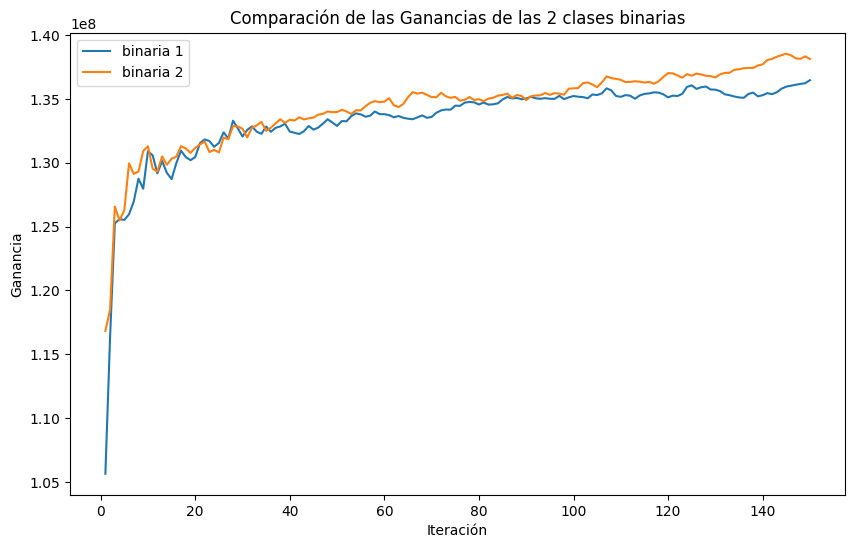

In [14]:
df_ganancias = pd.DataFrame({
    'binaria1': cv_results1['valid gan_eval-mean'],
    'binaria2': cv_results2['valid gan_eval-mean'],
    'Iteracion': range(1, len(cv_results1['valid gan_eval-mean']) + 1)
})

# Normalizamos la ganancias
df_ganancias['binaria1'] = df_ganancias['binaria1']*5
df_ganancias['binaria2'] = df_ganancias['binaria2']*5

plt.figure(figsize=(10, 6))
sns.lineplot(x='Iteracion', y='binaria1', data=df_ganancias, label='binaria 1')
sns.lineplot(x='Iteracion', y='binaria2', data=df_ganancias, label='binaria 2')
plt.title('Comparación de las Ganancias de las 2 clases binarias')
plt.xlabel('Iteración')
plt.ylabel('Ganancia')
plt.legend()
plt.show()


Se observa una ligera mejora al combinar las clases en modelos sencillos. Dado que cada pequeña mejora es importante, continuaremos utilizando esta estrategia.

A continuación, procederemos a optimizar **LightGBM** utilizando la librería **Optuna**. Cabe destacar que las optimizaciones que realizaremos son básicas y están diseñadas para ejecutarse en pocos minutos. Será su responsabilidad ampliar tanto el rango de búsqueda como el tiempo de optimización para obtener un modelo más competitivo.


In [15]:

def objective(trial):

    num_leaves = trial.suggest_int('num_leaves', 8, 100),
    learning_rate = trial.suggest_float('learning_rate', 0.005, 0.3), # mas bajo, más iteraciones necesita
    min_data_in_leaf = trial.suggest_int('min_data_in_leaf', 1, 1000),
    feature_fraction = trial.suggest_float('feature_fraction', 0.1, 1.0),
    bagging_fraction = trial.suggest_float('bagging_fraction', 0.1, 1.0),

    params = {
        'objective': 'binary',
        'metric': 'custom',
        'boosting_type': 'gbdt',
        'first_metric_only': True,
        'boost_from_average': True,
        'feature_pre_filter': False,
        'max_bin': 31,
        'num_leaves': num_leaves,
        'learning_rate': learning_rate,
        'min_data_in_leaf': min_data_in_leaf,
        'feature_fraction': feature_fraction,
        'bagging_fraction': bagging_fraction,
        'seed': semillas[0],
        'verbose': -1
    }
    train_data = lgb.Dataset(X_train,
                              label=y_train_binaria2, # eligir la clase
                              weight=w_train)
    cv_results = lgb.cv(
        params,
        train_data,
        num_boost_round=100, # modificar, subit y subir... y descomentar la línea inferior
        # early_stopping_rounds= int(50 + 5 / learning_rate),
        feval=lgb_gan_eval,
        stratified=True,
        nfold=5,
        seed=semillas[0]
    )
    max_gan = max(cv_results['valid gan_eval-mean'])
    best_iter = cv_results['valid gan_eval-mean'].index(max_gan) + 1

    # Guardamos cual es la mejor iteración del modelo
    trial.set_user_attr("best_iter", best_iter)

    return max_gan * 5


storage_name = "sqlite:///" + db_path + "optimization_lgbm.db"
study_name = "exp_301_lgbm"

study = optuna.create_study(
    direction="maximize",
    study_name=study_name,
    storage=storage_name,
    load_if_exists=True,
)

[I 2024-10-14 00:10:55,054] Using an existing study with name 'exp_301_lgbm' instead of creating a new one.


In [16]:
study.optimize(objective, n_trials=50) # subir subir

[I 2024-10-14 00:11:41,823] Trial 228 finished with value: 137221000.0 and parameters: {'num_leaves': 19, 'learning_rate': 0.10944119325293182, 'min_data_in_leaf': 340, 'feature_fraction': 0.18445158310342047, 'bagging_fraction': 0.1805359113463469}. Best is trial 221 with value: 151256000.0.
[I 2024-10-14 00:12:31,796] Trial 229 finished with value: 142352000.0 and parameters: {'num_leaves': 22, 'learning_rate': 0.1217144334348178, 'min_data_in_leaf': 310, 'feature_fraction': 0.23768288027862475, 'bagging_fraction': 0.1617487703505892}. Best is trial 221 with value: 151256000.0.
[I 2024-10-14 00:13:20,627] Trial 230 finished with value: 143815000.0 and parameters: {'num_leaves': 27, 'learning_rate': 0.10927252609856848, 'min_data_in_leaf': 388, 'feature_fraction': 0.22489094534338666, 'bagging_fraction': 0.11480669113937858}. Best is trial 221 with value: 151256000.0.
[I 2024-10-14 00:14:07,457] Trial 231 finished with value: 145852000.0 and parameters: {'num_leaves': 26, 'learning_ra

KeyboardInterrupt: 

Analizamos los resultados as usual

In [17]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [18]:
import plotly

In [19]:
pip install nbformat


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [20]:
#pip install --upgrade nbformat

^C
Note: you may need to restart the kernel to use updated packages.


In [21]:
import optuna.visualization as vis
vis.plot_optimization_history(study)
#optuna.visualization.plot_optimization_history(study)




In [22]:
plot_param_importances(study)

El **learning rate** es un parámetro que tiene que ir acompañado por más árboles.

In [23]:
plot_slice(study)

In [24]:
plot_contour(study)

In [25]:
plot_contour(study, params=['num_leaves','min_data_in_leaf'] )

Y finalmente tomamos el mejor modelo y lo entrenamos con la totalidad de los datos

In [26]:
best_iter = study.best_trial.user_attrs["best_iter"]
print(f"Mejor cantidad de árboles para el mejor model {best_iter}")
params = {
    'objective': 'binary',
    'boosting_type': 'gbdt',
    'first_metric_only': True,
    'boost_from_average': True,
    'feature_pre_filter': False,
    'max_bin': 31,
    'num_leaves': study.best_trial.params['num_leaves'],
    'learning_rate': study.best_trial.params['learning_rate'],
    'min_data_in_leaf': study.best_trial.params['min_data_in_leaf'],
    'feature_fraction': study.best_trial.params['feature_fraction'],
    'bagging_fraction': study.best_trial.params['bagging_fraction'],
    'seed': semillas[0],
    'verbose': 0
}

train_data = lgb.Dataset(X_train,
                          label=y_train_binaria2,
                          weight=w_train)

model = lgb.train(params,
                  train_data,
                  num_boost_round=best_iter)


Mejor cantidad de árboles para el mejor model 75


Observamos la variables más importantes para el modelo:

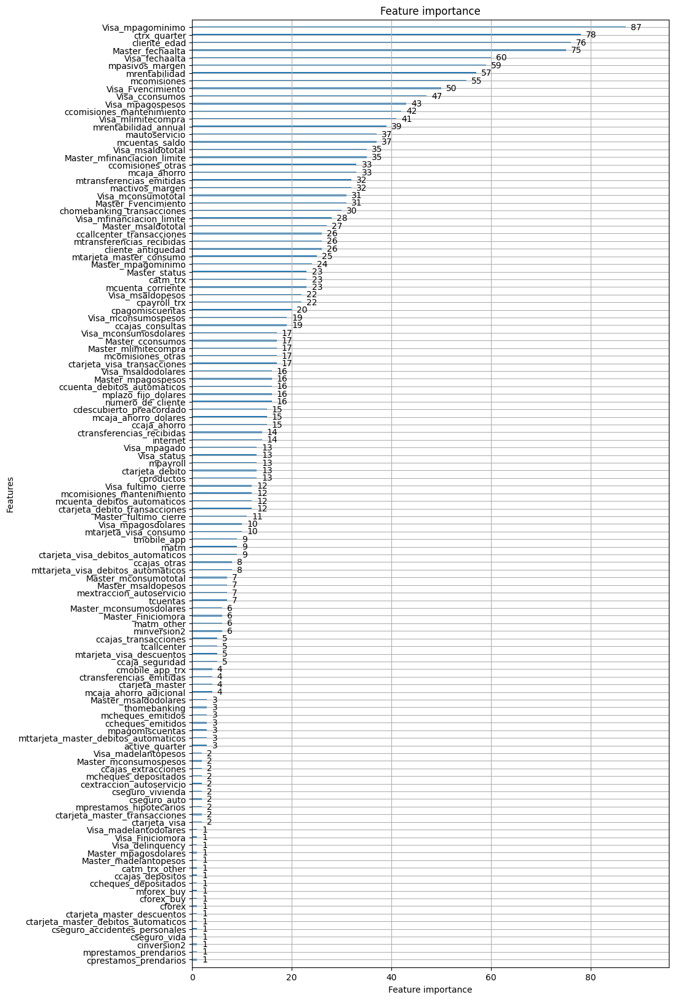

In [27]:
lgb.plot_importance(model, figsize=(10, 20))
plt.show()


Y si queremos tener las variables más importantes en forma de *Dataframe*:

In [28]:
importances = model.feature_importance()
feature_names = X_train.columns.tolist()
importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})
importance_df = importance_df.sort_values('importance', ascending=False)
importance_df[importance_df['importance'] > 0]


,feature,importance
151,Visa_mpagominimo,87
105,ctrx_quarter,78
5,cliente_edad,76
125,Master_fechaalta,75
147,Visa_fechaalta,60
...,...,...
74,cforex_buy,1
44,cseguro_vida,1
134,Visa_Finiciomora,1
73,cforex,1


Para guardar el modelo para poder utilizarlo más adelante, no es necesario guardarlo como *pickle*, la librería nos permite guardarlo en formato texto

In [29]:
model.save_model(modelos_path + 'lgb_first.txt')

Y recuperar el mismo desde ese formato

In [30]:
model = lgb.Booster(model_file=modelos_path + 'lgb_first.txt')

Para realizar nuestra habitual comparación de modelos, partiremos desde el mejor que obtuvimos hasta ahora, el **rf**. Para este fin cargaremos el *binario* que ajustamos un par de clases atrás:

In [31]:
#filename_rf_1000 = modelos_path + 'exp_206_random_forest_model_1000.sav'
#model_rf_1000 = pickle.load(open(filename_rf_1000, 'rb'))

Y sobre ambos modelos obtenemos la predicción de **Abril**

In [32]:
#y_pred_rf = model_rf_1000.predict_proba(Xif)
#y_pred_rf = y_pred_rf[:,1] # adaptamos la salida para que sea homogénea con el LGBM

y_pred_lgm = model.predict(X_test)

In [33]:

y_pred_prob = model.predict(X_test)

# Convertir a predicciones binarias usando un umbral de 0.025
threshold = 0.025
y_pred_binary = (y_pred_prob >= threshold).astype(int)

# Agregar las columnas de probabilidades y predicciones al DataFrame original
X_test['probabilidad'] = y_pred_prob
X_test['prediccion'] = y_pred_binary

# Ver las primeras filas del DataFrame original con las nuevas columnas
print(X_test.head(20))  # Muestra las primeras 20 filas


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Usuario\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


     numero_de_cliente  foto_mes  active_quarter  cliente_vip  internet  \
5            249667857    202106               1            0         0   
11           250095211    202106               1            0         0   
17           250305092    202106               1            0         0   
23           251706027    202106               1            0         0   
29           252325755    202106               1            0         0   
35           253166023    202106               1            0         0   
41           253941892    202106               1            0         0   
47           253957647    202106               1            0         0   
53           254740083    202106               1            0         0   
59           256560780    202106               1            0         0   
65           256730260    202106               1            0         0   
71           257776181    202106               1            0         0   
77           259095579   

In [34]:
X_test.prediccion.value_counts()

prediccion
0    148085
1     16791
Name: count, dtype: int64

In [35]:
# Filtrar el DataFrame para quedarte solo con 'numero_de_cliente' y 'prediccion'
result_df = X_test[['numero_de_cliente', 'prediccion']]

# Renombrar la columna 'prediccion' a 'Predicted' si es necesario
result_df.rename(columns={'prediccion': 'Predicted'}, inplace=True)

# Ver las primeras filas del DataFrame resultante
print(result_df.head())

    numero_de_cliente  Predicted
5           249667857          0
11          250095211          0
17          250305092          0
23          251706027          0
29          252325755          0


C:\Users\Usuario\AppData\Local\Temp\ipykernel_14224\3651937597.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [38]:
# Especificar la ruta completa del archivo donde deseas guardar el DataFrame
output_file = dataset_path + "resultados_predicciones.csv"

# Guardar el DataFrame como un archivo CSV en la ruta especificada
result_df.to_csv(output_file, index=False)

In [37]:
#y_pred_rf = model_rf_1000.predict_proba(Xif)
#y_pred_rf = y_pred_rf[:,1] # adaptamos la salida para que sea homogénea con el LGBM

#y_pred_lgm = model.predict(X_test)

NameError: name 'model_rf_1000' is not defined